In [1]:
import numpy as np

WIDTH = 395
HEIGHT = 860

In [2]:

import tensorflow as tf
config = tf.compat.v1.ConfigProto(gpu_options = 
                         tf.compat.v1.GPUOptions(per_process_gpu_memory_fraction=0.8)
# device_count = {'GPU': 1}
)
config.gpu_options.allow_growth = True
session = tf.compat.v1.Session(config=config)
tf.compat.v1.keras.backend.set_session(session)

In [3]:
import keras
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout, Flatten, Conv2D, MaxPooling2D
from keras.layers.normalization import BatchNormalization
import numpy as np

from keras.models import Sequential
from keras.models import Model
from keras.callbacks import ModelCheckpoint, LearningRateScheduler, EarlyStopping, ReduceLROnPlateau, TensorBoard
from keras import optimizers, losses, activations, models
from keras.layers import Convolution2D, Dense, Input, Flatten, Dropout, MaxPooling2D, BatchNormalization, GlobalAveragePooling2D, Concatenate
from keras import applications
input_shape = (150, 300,3)
nclass = 9

base_model = applications.InceptionV3(weights='imagenet', 
                                include_top=False, 
                                input_shape=(150, 300,3))
base_model.trainable = True

add_model = Sequential()
add_model.add(base_model)
add_model.add(GlobalAveragePooling2D())
add_model.add(Dropout(0.5))

add_model.add(Dense(4096*2, 
                    activation='relu'))

add_model.add(Dense(4096, 
                    activation='relu'))
add_model.add(Dense(nclass, 
                    activation='softmax'))

model = add_model

model.compile(loss='categorical_crossentropy', 
              optimizer=optimizers.Adam(lr=1e-1, 
                                       ),
              metrics=['accuracy'])
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
inception_v3 (Functional)    (None, 3, 8, 2048)        21802784  
_________________________________________________________________
global_average_pooling2d (Gl (None, 2048)              0         
_________________________________________________________________
dropout (Dropout)            (None, 2048)              0         
_________________________________________________________________
dense (Dense)                (None, 8192)              16785408  
_________________________________________________________________
dense_1 (Dense)              (None, 4096)              33558528  
_________________________________________________________________
dense_2 (Dense)              (None, 9)                 36873     
Total params: 72,183,593
Trainable params: 72,149,161
Non-trainable params: 34,432
_______________________________________

In [4]:
model = keras.models.load_model('C:/Users/Ant Pc/GitHub/AI-in-Mfg---Automated-Driving/Aaftab/ninna.h5')

In [5]:
'''
import pandas as pd

y_full=[]
for i in range(1,63):
    if i!=2:
        file_name = 'E:/New folder/Data/niranjan/training_data-{}.npy'.format(i)
        # full file info
        train_data = np.load(file_name,allow_pickle=True)
        train_data=pd.DataFrame(train_data)
        Y = train_data[1]
        y_full.append(Y)
        print(len(y_full))
    else:
        print('error')


from sklearn.preprocessing import LabelEncoder
y_full=np.array(y_full)
print(y_full.shape)
y_full=np.reshape(y_full,(61*500,9))
print(y_full.shape)
df_y=pd.DataFrame(y_full)
df_y=df_y.astype('float64')
print(df_y.head())
# Create a pd.series that represents the categorical class of each one-hot encoded row
y_classes = df_y.idxmax(1, skipna=False)

# Instantiate the label encoder
le = LabelEncoder()

# Fit the label encoder to our label serie
le.fit(list(y_classes))

# Create integer based labels Series
y_integers = le.transform(list(y_classes))

# Create dict of labels : integer representation
labels_and_integers = dict(zip(y_classes, y_integers))

from sklearn.utils.class_weight import compute_class_weight, compute_sample_weight

class_weights = compute_class_weight('balanced', np.unique(y_integers), y_integers)
sample_weights = compute_sample_weight('balanced', y_integers)

cw = dict(zip(le.transform(list(le.classes_)), class_weights))
print(cw)'''
cw={0: 0.49843931297086175, 1: 1.3119972469565966, 2: 1.5762273901808785, 3: 1.6694033935413246, 4: 1.9178771301012387, 5: 3.4231200897867566, 6: 9.15915915915916, 7: 135.55555555555554, 8: 0.24582104228121926}

In [ ]:
EPOCHS=100
import pandas as pd
import numpy as np
from random import shuffle
from keras.preprocessing.image import ImageDataGenerator


from sklearn.preprocessing import LabelEncoder

for d in range(EPOCHS):
    data_order = [i for i in range(1,62+1)]
    shuffle(data_order)
    loss=0
    acc=0
    valacc=0
    valloss=0
    for count,i in enumerate(data_order):
        
        try:
            file_name = 'E:/New folder/Data/niranjan/training_data-{}.npy'.format(i)
            # full file info
            train_data = np.load(file_name,allow_pickle=True)
            
            import cv2
            X=np.zeros([450,150,300,3])
            test_x=np.zeros([50,150,300,3])
            
            Y=np.zeros([450,9])
            test_y=np.zeros([50,9])
            for j in range(len(train_data)):
                if j < 450:
                    a=train_data[j,0]
                    a=cv2.resize(a,(300,150))
                    X[j]=a
                    Y[j]=train_data[j,1]
                else:
                    a=train_data[j,0]
                    a=cv2.resize(a,(300,150))
                    test_x[j-450]=a
                    test_y[j-450]=train_data[j,1]

            X=np.asarray(X).astype(np.float16)
            Y=np.asarray(Y).astype(np.float16)
            
            test_x=np.asarray(test_x).astype(np.uint16)
            test_y=np.asarray(test_y).astype(np.uint16)
            if i%50==0:
                v=1
            else:v=0
            
            h=model.fit(X,Y, batch_size=2, epochs = 1, validation_data = (test_x, test_y),class_weight=cw,verbose=v)

            loss=loss+h.history['loss']
            valloss=valloss+h.history['val_loss']
            acc=acc+h.history['accuracy']
            valacc=valacc+h.history['val_accuracy']         
            print(count)
            if count%10 == 0:
                #print('SAVING MODEL!')
                print(loss,valloss)
                print(acc,valacc,d)
                model.save('ninna.h5')
                    
        except Exception as e:
            #print(str(e))
            pass
    

In [ ]:
model.save('keras.h5')

In [1]:
import torch

#imports necessary to define a neural network 
import torch.nn as nn
import torch.nn.functional as F

#ensure you are using GPU.
if torch.cuda.is_available():  
  dev = "cuda:0" 
else:  
  dev = "cpu"  

device = torch.device(dev)
print(device)

dtype = torch.cuda.FloatTensor

cuda:0


In [2]:
model = torch.hub.load('pytorch/vision:v0.6.0', 'inception_v3', pretrained=True)
model.fc = nn.Linear(2048, 9)
model.eval()

Using cache found in C:\Users\Ant Pc/.cache\torch\hub\pytorch_vision_v0.6.0


Inception3(
  (Conv2d_1a_3x3): BasicConv2d(
    (conv): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2a_3x3): BasicConv2d(
    (conv): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2b_3x3): BasicConv2d(
    (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_3b_1x1): BasicConv2d(
    (conv): Conv2d(64, 80, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_4a_3x3): BasicConv2d(
    (conv): Conv2d(80, 192, kernel_size=(3, 3), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(192, eps=0.001, momentum=0.1, affine=True, t

In [3]:
model=model.cuda()
model.load_state_dict(torch.load('C:/Users/Ant Pc/GitHub/AI-in-Mfg---Automated-Driving/Aaftab/vijincepbalance.pt'))
model.eval()

Inception3(
  (Conv2d_1a_3x3): BasicConv2d(
    (conv): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2a_3x3): BasicConv2d(
    (conv): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2b_3x3): BasicConv2d(
    (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_3b_1x1): BasicConv2d(
    (conv): Conv2d(64, 80, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_4a_3x3): BasicConv2d(
    (conv): Conv2d(80, 192, kernel_size=(3, 3), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(192, eps=0.001, momentum=0.1, affine=True, t

In [49]:
import numpy as np
from grabscreen import grab_screen
import cv2
import time
from directkeys import PressKey,ReleaseKey, W, A, S, D
from getkeys import key_check

import random
t_time = 0.09
w = [1,0,0,0,0,0,0,0,0]
s = [0,1,0,0,0,0,0,0,0]
a = [0,0,1,0,0,0,0,0,0]
d = [0,0,0,1,0,0,0,0,0]
wa = [0,0,0,0,1,0,0,0,0]
wd = [0,0,0,0,0,1,0,0,0]
sa = [0,0,0,0,0,0,1,0,0]
sd = [0,0,0,0,0,0,0,1,0]
nk = [0,0,0,0,0,0,0,0,1]

def straight():
    PressKey(W)
    ReleaseKey(A)
    ReleaseKey(D)
    ReleaseKey(S)

def left():
    if random.randrange(0,3) == 1:
        PressKey(W)
    else:
        ReleaseKey(W)
    PressKey(A)
    ReleaseKey(S)
    ReleaseKey(D)
    #ReleaseKey(S)

def right():
    if random.randrange(0,3) == 1:
        PressKey(W)
    else:
        ReleaseKey(W)
    PressKey(D)
    ReleaseKey(A)
    ReleaseKey(S)
    
def reverse():
    PressKey(S)
    ReleaseKey(A)
    ReleaseKey(W)
    ReleaseKey(D)


def forward_left():
    PressKey(W)
    PressKey(A)
    ReleaseKey(D)
    ReleaseKey(S)
    
    
def forward_right():
    PressKey(W)
    PressKey(D)
    ReleaseKey(A)
    ReleaseKey(S)

    
def reverse_left():
    PressKey(S)
    PressKey(A)
    ReleaseKey(W)
    ReleaseKey(D)

    
def reverse_right():
    PressKey(S)
    PressKey(D)
    ReleaseKey(W)
    ReleaseKey(A)

def no_keys():

    if random.randrange(0,3) == 1:
        PressKey(W)
    else:
        ReleaseKey(W)
    ReleaseKey(A)
    ReleaseKey(S)
    ReleaseKey(D)

def main():
    last_time = time.time()
    for i in list(range(4))[::-1]:
        print(i+1)
        time.sleep(1)

    paused = False
    while(True):
        keys = key_check()
        if True:
            if 'T' in keys:
                if paused:
                    paused = False
                    time.sleep(1)
            else:
                paused = True
                ReleaseKey(A)
                ReleaseKey(W)
                ReleaseKey(D)
                time.sleep(1)
            # 800x600 windowed mode
            #screen =  np.array(ImageGrab.grab(bbox=(0,40,800,640)))
            screen = grab_screen(region=(0,80,910,475))
            last_time = time.time()
            screen = cv2.cvtColor(screen, cv2.COLOR_BGR2RGB)
            screen = cv2.resize(screen, (150,150))
            plt.imshow(screen)
            plt.show()
            st=torch.from_numpy(screen.reshape(1,3,150,150)).type(dtype)
            prediction = model(st)[0]
            a=torch.nn.Softmax()
            prediction=a(prediction)
            prediction=prediction.detach().cpu().numpy()
            
            mode_choice = np.argmax(prediction)
            print(prediction)
            print(mode_choice)
            if mode_choice == 0:
                straight()
                choice_picked = 'straight'
                
            elif mode_choice ==1:
                reverse()
                choice_picked = 'reverse'
                
            elif mode_choice == 2:
                forward_left()
                choice_picked = 'left'
            elif mode_choice == 3:
                forward_right()
                choice_picked = 'right'
            elif mode_choice == 4:
                forward_left()
                choice_picked = 'forward+left'
            elif mode_choice == 5:
                forward_right()
                choice_picked = 'forward+right'
            elif mode_choice == 6:
                reverse_left()
                choice_picked = 'reverse+left'
            elif mode_choice == 7:
                reverse_right()
                choice_picked = 'reverse+right'
            elif mode_choice == 8:
                no_keys()
                choice_picked = 'nokeys'

        
        print(choice_picked)
        # p pauses game and can get annoying.
       



4
3
2
1


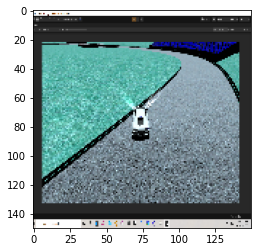

<ipython-input-49-06ac67790388>:120: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  prediction=a(prediction)


[5.2150846e-01 5.1063245e-07 4.6836519e-01 1.3666153e-05 3.8880745e-03
 2.5188103e-06 8.6069532e-04 3.7595967e-08 5.3608119e-03]
0
straight


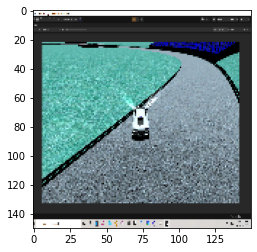

[3.2868046e-01 1.8910401e-05 1.7643858e-01 2.2353028e-05 9.2690194e-04
 3.9367688e-07 3.9524949e-01 2.3510660e-07 9.8662645e-02]
6
reverse+left


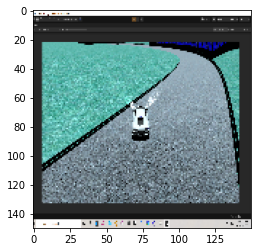

[9.5444006e-01 4.1889834e-06 4.1806512e-02 8.6579130e-05 3.1727008e-04
 1.2339765e-07 3.1221012e-04 9.5238439e-10 3.0330780e-03]
0
straight


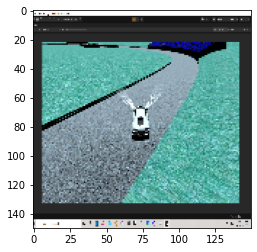

[5.4866001e-02 3.6009410e-03 3.7871550e-03 2.9965766e-02 4.8355323e-05
 3.6765181e-05 3.8496254e-04 7.7606877e-05 9.0723246e-01]
8
nokeys


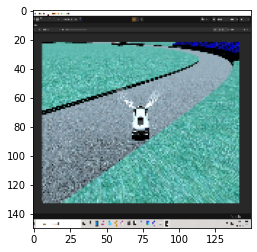

[3.6788930e-04 1.5734361e-06 3.9761138e-04 3.6965883e-03 3.1872056e-05
 2.8738910e-07 2.4068074e-08 9.9546486e-01 3.9229100e-05]
7
reverse+right


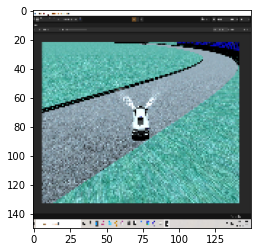

[3.4158383e-04 2.4450232e-05 3.7479082e-01 3.2543483e-01 2.4112029e-04
 1.6907342e-07 5.3101230e-05 4.5970059e-03 2.9451689e-01]
2
left


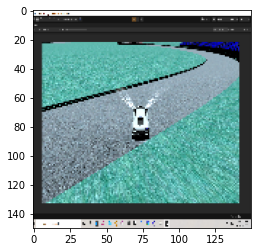

[1.82477944e-03 7.34931382e-06 8.74919910e-03 3.32964659e-01
 1.10455185e-04 5.89863873e-07 7.72889734e-07 4.24054712e-01
 2.32287467e-01]
7
reverse+right


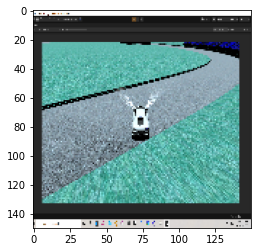

[9.4483333e-04 1.8837821e-04 3.5789828e-03 5.8089775e-01 1.5486845e-05
 6.5961445e-05 3.4681013e-06 2.7318618e-01 1.4111899e-01]
3
right


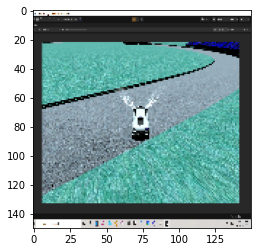

[1.8639811e-03 2.0450818e-06 4.8559257e-03 8.8993013e-01 1.5962073e-04
 1.3532954e-06 1.2884062e-05 4.8664631e-03 9.8307557e-02]
3
right


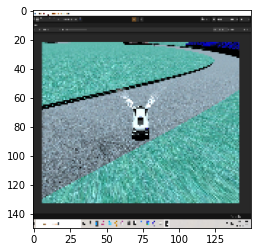

[4.0416626e-06 2.3302555e-06 1.9123526e-03 6.2090236e-05 2.6637354e-05
 5.9433042e-11 9.8533724e-07 9.9771798e-01 2.7358686e-04]
7
reverse+right


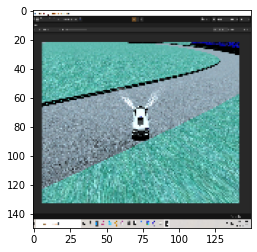

[4.9439822e-03 1.7773615e-05 7.9043012e-04 3.6543927e-01 6.1375245e-06
 2.8442813e-05 9.3463473e-07 4.5459140e-03 6.2422717e-01]
8
nokeys


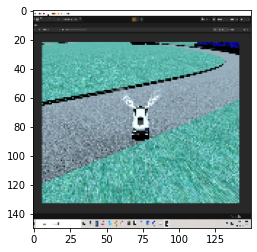

[4.2648785e-02 9.7577481e-07 3.6900750e-04 5.5022770e-01 2.4805991e-06
 9.2567820e-03 2.5540137e-08 1.1401921e-05 3.9748281e-01]
3
right


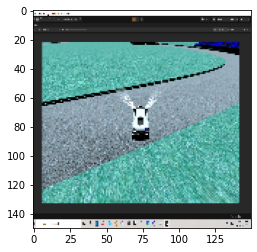

[7.7396471e-05 6.5486802e-07 9.3837921e-04 5.6967986e-01 4.9087383e-08
 4.9660542e-07 3.4904617e-09 2.3812147e-04 4.2906511e-01]
3
right


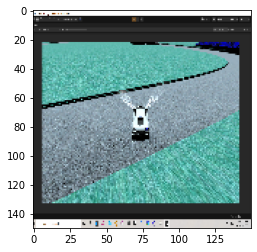

[5.0656724e-04 4.3955047e-06 5.5145030e-03 9.2575282e-01 1.1355579e-06
 2.8454352e-07 4.5489479e-09 2.0936960e-03 6.6126689e-02]
3
right


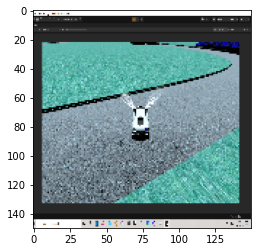

[2.10390263e-03 6.20231222e-05 9.81401652e-02 5.04248738e-01
 7.25671562e-05 5.76588519e-08 1.79467097e-04 2.83344954e-01
 1.11848086e-01]
3
right


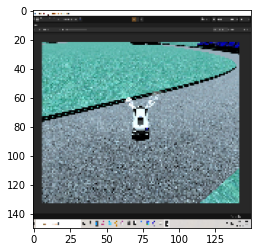

[1.9860879e-06 2.3530673e-08 4.2050480e-05 3.6022335e-02 8.2504152e-07
 1.7579410e-12 1.4914631e-06 9.5496541e-01 8.9660147e-03]
7
reverse+right


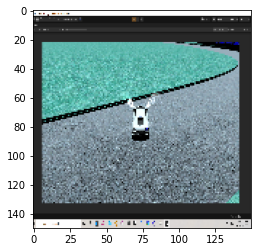

[5.8119007e-05 1.0721769e-04 1.6151660e-05 2.8951454e-04 6.7014504e-08
 6.2346423e-08 6.3286770e-06 9.4494396e-01 5.4578625e-02]
7
reverse+right


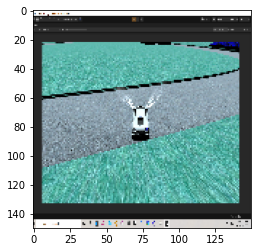

[4.0939832e-03 1.8595956e-02 1.3779954e-02 4.3674549e-01 8.5107080e-05
 3.1261054e-05 4.1355379e-04 1.4833557e-02 5.1142108e-01]
8
nokeys


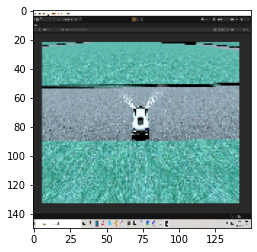

[1.4385823e-03 5.6735207e-06 1.8739199e-02 7.1549898e-01 3.7610855e-06
 9.2543348e-07 6.1921934e-10 1.5168627e-05 2.6429769e-01]
3
right


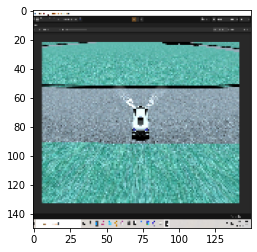

[4.2596078e-04 6.3786727e-05 2.5949346e-02 2.7384050e-03 1.0789768e-08
 1.8986466e-05 2.0582633e-04 3.5464016e-01 6.1595756e-01]
8
nokeys


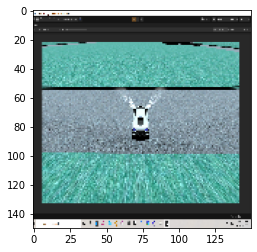

[2.9505443e-04 4.7139809e-04 4.5542587e-03 3.1049941e-03 1.8052313e-05
 4.6174131e-07 1.9205401e-04 4.1147945e-03 9.8724896e-01]
8
nokeys


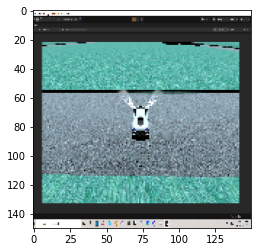

[2.2949199e-03 1.0764047e-03 1.1644037e-03 2.6333127e-03 5.4127554e-06
 2.8573815e-05 4.2850646e-04 6.9933593e-02 9.2243487e-01]
8
nokeys


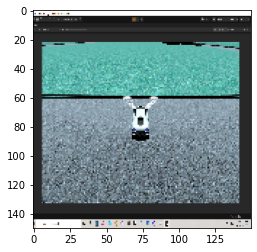

[2.3962306e-02 2.6171727e-04 6.4363107e-03 5.9305887e-05 1.2731820e-04
 4.3171735e-06 9.0898536e-03 6.1349499e-01 3.4656388e-01]
7
reverse+right


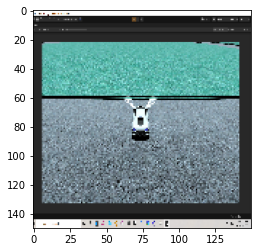

[1.9601383e-03 6.5029203e-04 6.6490367e-04 5.9392398e-05 2.1206622e-05
 3.6657863e-07 3.7024973e-04 7.3500252e-01 2.6127091e-01]
7
reverse+right


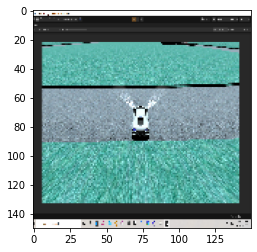

[3.9449144e-02 2.5595608e-07 5.1082259e-01 1.2350599e-03 1.9125690e-05
 1.0074725e-05 2.4463664e-09 7.2593963e-08 4.4846368e-01]
2
left


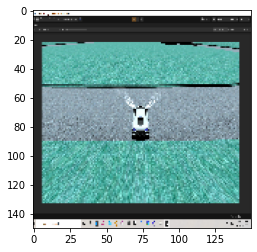

[4.0060598e-02 5.2094727e-04 1.1438701e-01 8.7967172e-02 2.6846235e-04
 4.3479871e-05 3.8741170e-08 1.6213882e-07 7.5675213e-01]
8
nokeys


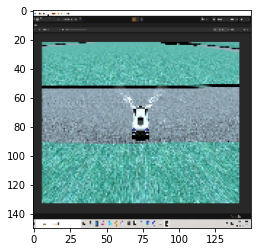

[3.6047615e-02 7.6384917e-05 3.2501182e-01 5.9296340e-03 5.0414191e-04
 1.0322669e-05 1.0905911e-04 1.0422396e-02 6.2188870e-01]
8
nokeys


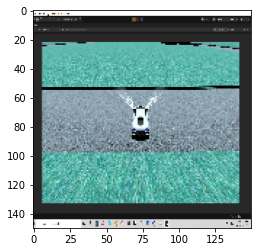

[3.4770160e-04 1.4564736e-02 5.2889943e-02 1.6104802e-04 3.0646024e-05
 2.0948360e-07 5.2985914e-02 1.9385314e-01 6.8516672e-01]
8
nokeys


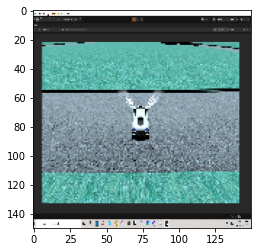

[1.5460364e-02 8.2051130e-03 1.4190655e-03 1.6492147e-02 1.2440879e-04
 7.6151453e-05 6.2403051e-05 2.4573787e-04 9.5791465e-01]
8
nokeys


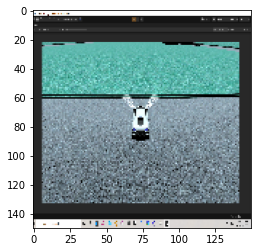

[4.0457118e-02 7.0946917e-02 2.9000675e-03 2.4265601e-04 5.6834314e-03
 4.9152909e-06 1.6894760e-03 6.7895389e-01 1.9912153e-01]
7
reverse+right


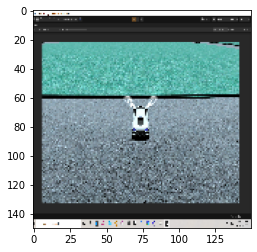

[7.2186644e-04 5.3576485e-05 1.2909101e-03 1.2265282e-05 4.9557634e-06
 1.8318588e-06 2.3446574e-04 4.6198752e-02 9.5148134e-01]
8
nokeys


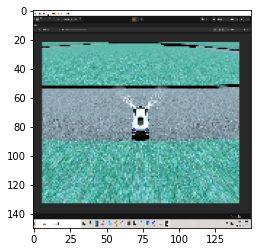

[4.3563977e-02 3.4964080e-06 5.4057018e-04 7.4354786e-01 1.1648223e-03
 7.8571749e-05 4.4632863e-08 1.0522402e-05 2.1109009e-01]
3
right


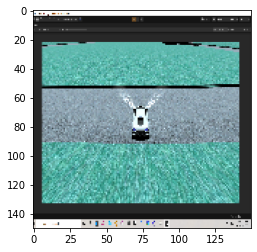

[1.09447814e-04 6.79416844e-05 4.59292419e-02 1.07000943e-03
 5.37608003e-07 1.63343771e-07 4.71102190e-04 8.03967237e-01
 1.48384333e-01]
7
reverse+right


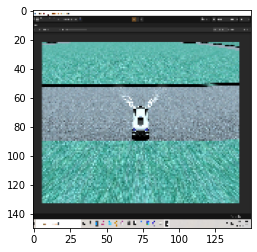

[1.6507348e-02 1.1403786e-04 5.9265614e-02 1.5865585e-03 8.8018482e-05
 1.2663994e-06 2.4454078e-08 1.2938009e-05 9.2242420e-01]
8
nokeys


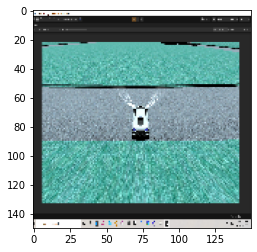

[1.57359280e-02 1.37847974e-05 7.96441510e-02 2.24860877e-01
 4.98636837e-05 1.50571905e-05 7.89235628e-08 3.30908136e-07
 6.79679930e-01]
8
nokeys


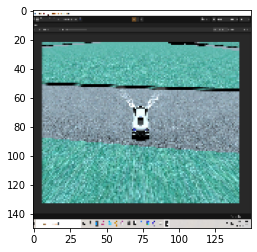

[4.7414729e-04 1.1233393e-03 1.4182996e-02 3.9734656e-04 4.0101440e-06
 1.7970385e-07 7.2328585e-05 1.9528754e-06 9.8374385e-01]
8
nokeys


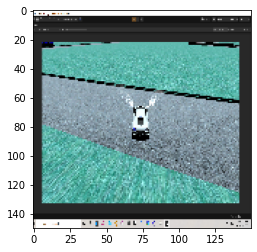

[6.7825136e-03 4.8251491e-04 5.0139058e-01 7.9629548e-02 6.5795386e-05
 2.4119141e-05 1.1882937e-04 2.0481965e-02 3.9102405e-01]
2
left


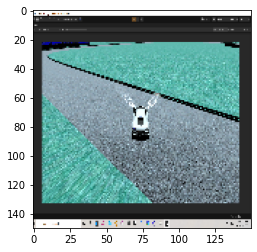

[3.9053324e-01 6.6311193e-05 4.3054080e-01 2.4896993e-03 6.3678399e-03
 3.9380364e-05 6.0731091e-04 1.1332712e-02 1.5802267e-01]
2
left


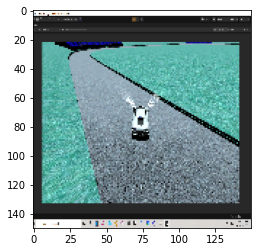

[1.5598164e-03 4.4973311e-03 3.3547731e-06 2.0812464e-01 2.2963744e-05
 2.5152968e-04 1.9045738e-06 1.2856593e-03 7.8425282e-01]
8
nokeys


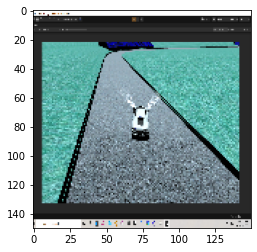

[9.5949173e-02 1.3949985e-06 6.6010624e-01 2.8624840e-03 1.7260562e-01
 5.6432424e-07 4.9579173e-02 1.1924047e-06 1.8894181e-02]
2
left


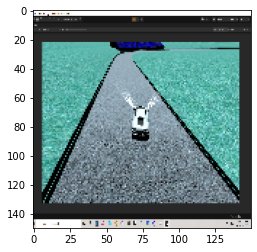

[1.1766584e-03 1.7855698e-03 3.0161289e-04 1.4544989e-02 4.5737706e-06
 3.8548794e-07 1.3009315e-04 9.8194408e-01 1.1206550e-04]
7
reverse+right


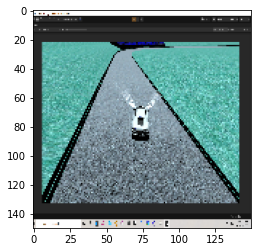

[5.8170152e-03 4.3334216e-03 6.6622680e-01 5.8992708e-04 1.2014104e-04
 1.7336389e-07 5.7401666e-03 2.4939177e-03 3.1467840e-01]
2
left


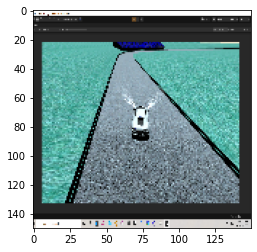

[1.5782566e-01 3.5291846e-06 2.1029188e-01 1.3807858e-03 5.7763106e-01
 1.4813514e-05 1.1833678e-05 5.6120922e-04 5.2279182e-02]
4
forward+left


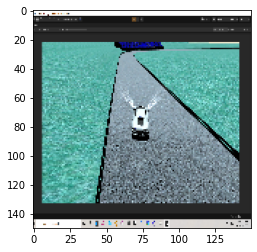

[5.1952279e-01 2.3816581e-05 2.2207765e-01 1.4878431e-02 3.2560225e-03
 6.7585929e-06 1.3364045e-05 1.1228241e-06 2.4022010e-01]
0
straight


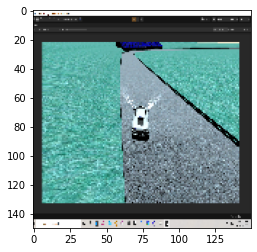

[1.8252581e-01 3.5632864e-04 8.8636251e-03 5.0296187e-01 8.6343571e-05
 1.1178747e-02 1.7843152e-04 5.9507589e-04 2.9325378e-01]
3
right


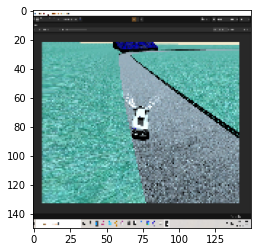

[3.3277434e-03 1.6200180e-01 2.3973125e-01 6.3601706e-06 3.5110531e-06
 4.1754293e-09 3.8699591e-01 5.7986612e-04 2.0735349e-01]
6
reverse+left


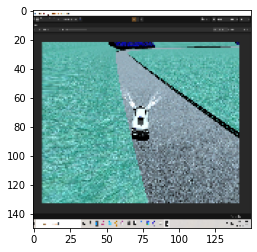

[3.7983868e-02 3.0014871e-07 9.5454419e-01 2.8025714e-04 6.3557579e-04
 1.3322201e-06 6.2409844e-03 9.2310114e-07 3.1258742e-04]
2
left


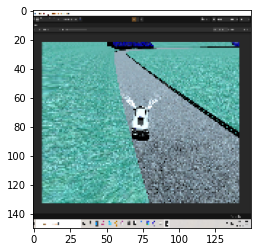

[2.9641105e-02 8.4581794e-03 4.8454651e-01 4.8631118e-05 1.3202553e-04
 4.5923602e-07 4.2825654e-01 5.9217663e-04 4.8324317e-02]
2
left


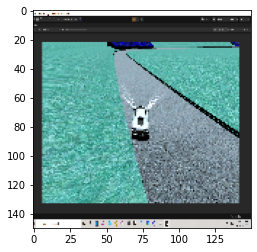

[1.97023928e-01 2.09467791e-04 7.35344708e-01 1.02989461e-05
 3.28415772e-03 1.41284345e-05 2.36807112e-02 2.89776275e-04
 4.01427709e-02]
2
left


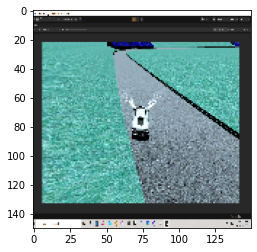

[1.5428734e-01 4.9057527e-04 6.1870545e-01 5.3096522e-04 2.7523332e-03
 4.2671536e-06 1.8596093e-01 1.5537475e-05 3.7252624e-02]
2
left


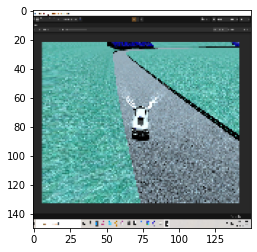

[1.0799603e-01 9.7118136e-06 8.5869890e-01 4.6447181e-05 1.2378052e-02
 8.8854511e-05 7.4793687e-03 4.8034501e-05 1.3254609e-02]
2
left


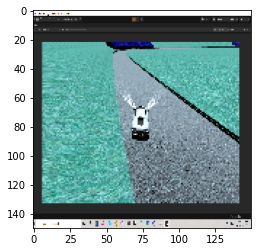

[2.1559550e-01 3.0415421e-04 5.8698344e-01 2.3419513e-04 2.2347547e-02
 3.5430869e-04 1.4993028e-01 5.4291310e-04 2.3707625e-02]
2
left


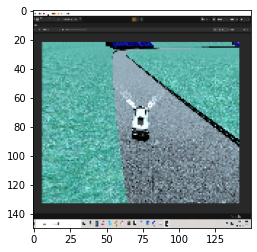

[3.0426422e-01 2.5280932e-04 2.6950505e-01 5.7282461e-05 6.6153537e-03
 3.1672931e-05 3.0881217e-01 3.6592610e-02 7.3868759e-02]
6
reverse+left


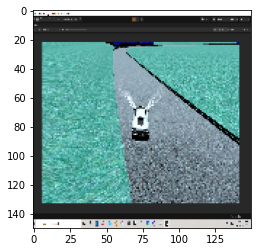

[6.4183876e-02 7.3677445e-05 7.6275480e-01 9.8094770e-06 3.3929870e-03
 5.6189119e-06 1.4813853e-02 1.3720919e-03 1.5339333e-01]
2
left


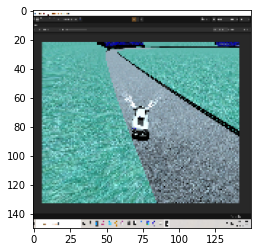

[3.3524685e-02 6.2699187e-06 7.5225735e-01 4.0515706e-06 4.9222996e-03
 5.5782169e-07 1.1122908e-01 2.9558970e-07 9.8055415e-02]
2
left


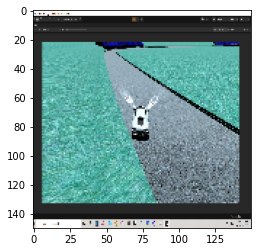

[4.9600401e-04 1.2810136e-07 9.8969406e-01 1.2012275e-06 1.2040472e-05
 2.4599353e-10 1.0209676e-03 8.9573493e-10 8.7756226e-03]
2
left


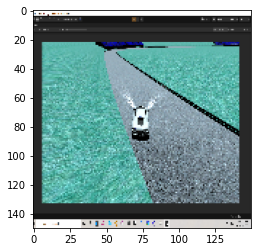

[8.3603998e-05 6.6678723e-08 9.7124332e-01 7.4166330e-08 5.3391608e-07
 3.3150205e-11 1.6243497e-04 1.4989667e-11 2.8510051e-02]
2
left


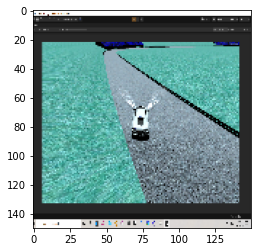

[1.0662959e-04 6.2682739e-07 9.6692061e-01 2.1565088e-06 2.6049338e-07
 1.5972698e-10 4.5849860e-04 1.1159092e-08 3.2511175e-02]
2
left


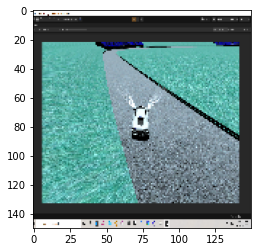

[2.8004430e-02 1.6897063e-04 7.7906346e-01 5.3436554e-04 6.2399416e-04
 3.6824006e-09 3.9464394e-03 1.8079543e-06 1.8765646e-01]
2
left


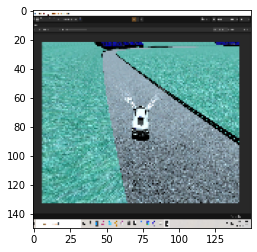

[5.3715962e-03 2.1959994e-04 7.4291307e-01 4.0423865e-06 2.4658965e-04
 1.3190341e-07 1.4561472e-03 1.2438437e-04 2.4966450e-01]
2
left


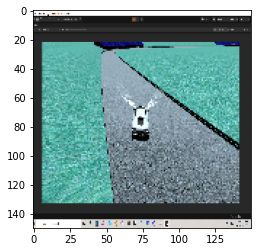

[2.0117478e-02 9.5298130e-04 2.3388283e-01 8.1056925e-05 1.1784955e-03
 6.7999245e-08 3.9496212e-03 1.9102855e-02 7.2073460e-01]
8
nokeys


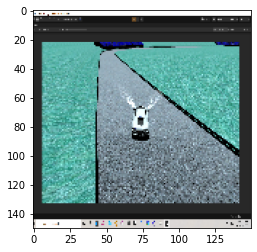

[1.20291775e-02 3.32243108e-05 9.47545588e-01 1.33899794e-05
 3.75556340e-03 7.75100517e-09 4.10020235e-04 7.07674888e-04
 3.55052687e-02]
2
left


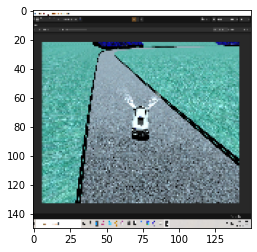

[6.9150138e-01 5.1544979e-03 2.9623374e-01 5.2991763e-06 2.1974085e-04
 5.1872013e-07 6.2382161e-03 8.1732505e-06 6.3841505e-04]
0
straight


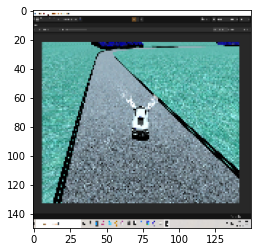

[1.55768856e-01 3.02514490e-02 8.23595678e-04 7.33352639e-03
 2.88498813e-05 2.68963532e-07 1.39038265e-02 1.30819355e-03
 7.90581405e-01]
8
nokeys


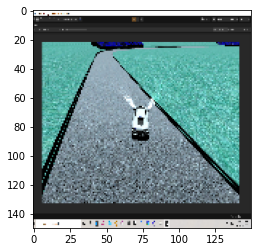

[7.5294981e-03 1.8901464e-04 2.6513364e-02 1.0865424e-04 1.6585129e-05
 3.5338097e-09 1.2609824e-02 4.9925711e-05 9.5298308e-01]
8
nokeys


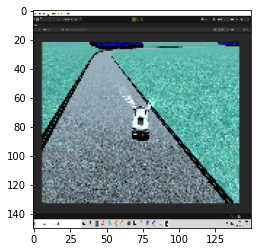

[1.37426987e-01 3.39607868e-06 1.85573241e-03 8.91524451e-06
 4.38778261e-06 1.02944375e-10 2.40926147e-01 9.81485518e-11
 6.19774461e-01]
8
nokeys


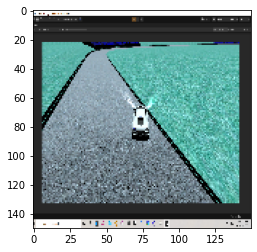

[2.6291269e-01 1.8316227e-07 1.3931104e-05 4.2647008e-02 4.3686865e-05
 1.4465250e-07 4.4520793e-06 6.9998532e-07 6.9437724e-01]
8
nokeys


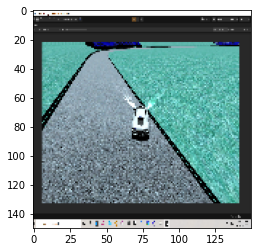

[1.02201715e-01 2.40694644e-05 5.53560495e-01 8.71688753e-05
 2.03136308e-03 6.74893172e-08 3.24777626e-02 3.62504470e-05
 3.09581101e-01]
2
left


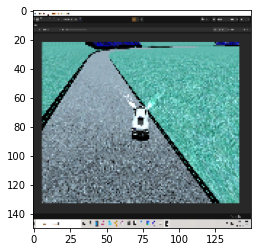

[1.79600827e-02 1.45399122e-06 5.81469573e-02 1.86856766e-03
 4.62701515e-04 1.76204615e-08 1.03944145e-01 2.44164630e-06
 8.17613721e-01]
8
nokeys


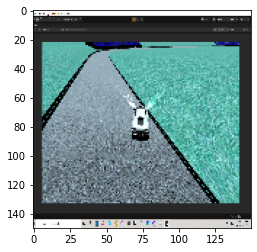

[3.4210313e-02 3.6093645e-06 1.2180504e-01 4.7408705e-04 2.4012779e-04
 1.2544958e-08 5.8198925e-02 3.1459453e-07 7.8506756e-01]
8
nokeys


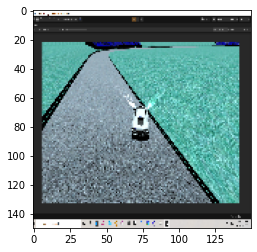

[2.9842714e-02 4.2949987e-06 1.1928413e-01 5.0444633e-04 2.4924747e-04
 1.0799842e-08 6.6614173e-02 5.4804485e-07 7.8350037e-01]
8
nokeys


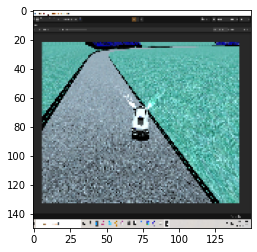

[3.1086236e-02 4.1711269e-06 1.2043870e-01 5.1384425e-04 2.4735910e-04
 1.2934615e-08 5.4031033e-02 4.2038391e-07 7.9367822e-01]
8
nokeys


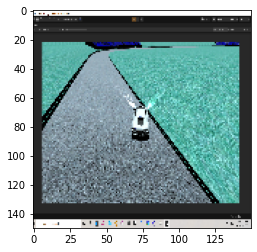

[3.5502121e-02 3.4705315e-06 1.1295254e-01 5.5279036e-04 2.6332284e-04
 1.3429217e-08 5.2822642e-02 3.5437421e-07 7.9790276e-01]
8
nokeys


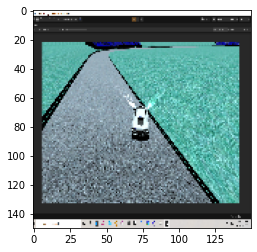

[3.2485958e-02 3.8203157e-06 1.1897600e-01 5.3083705e-04 2.7982914e-04
 1.1791737e-08 5.4156516e-02 5.5573048e-07 7.9356641e-01]
8
nokeys


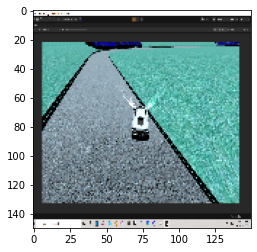

[1.5658671e-02 1.2588925e-08 1.4681588e-03 7.1858605e-03 1.7776695e-06
 9.1536208e-08 2.7464268e-06 5.9392445e-08 9.7568274e-01]
8
nokeys


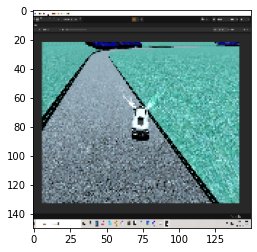

[1.89245958e-02 9.00872266e-08 3.22942476e-04 1.00088725e-02
 5.52944243e-07 2.65595190e-07 1.87505881e-04 1.15990112e-07
 9.70555007e-01]
8
nokeys


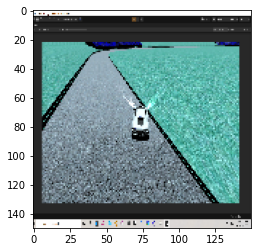

[5.38340118e-03 4.12333748e-07 1.10239070e-03 9.93625377e-04
 1.58432741e-07 1.26680275e-08 6.02705622e-05 1.00610237e-06
 9.92458761e-01]
8
nokeys


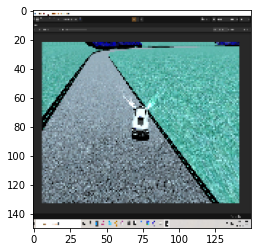

[6.7256866e-03 1.2944461e-06 4.2109529e-04 1.6002520e-03 5.8422984e-07
 6.5635062e-09 2.4473196e-04 9.4954257e-06 9.9099684e-01]
8
nokeys


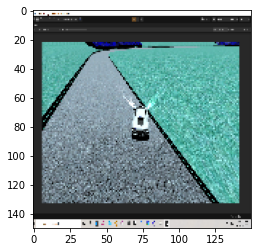

[6.3985190e-03 1.2847956e-06 4.2879506e-04 1.4145859e-03 7.2545760e-07
 6.4386394e-09 2.6191067e-04 8.3645718e-06 9.9148577e-01]
8
nokeys


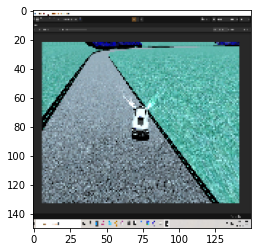

[6.2708561e-03 1.3825278e-06 4.6192043e-04 1.4614958e-03 6.6139467e-07
 6.0949423e-09 2.9571715e-04 9.6532985e-06 9.9149829e-01]
8
nokeys


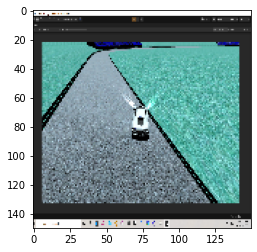

[6.7537867e-02 1.1304369e-05 4.7647604e-04 1.3535020e-01 3.5565108e-08
 1.4118870e-08 1.0668319e-01 1.6653548e-05 6.8992436e-01]
8
nokeys


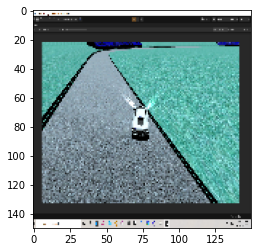

[1.9001862e-02 6.3414955e-06 2.7587489e-04 8.1158340e-02 1.7293303e-08
 1.3965174e-08 1.8846562e-02 1.9533192e-04 8.8051569e-01]
8
nokeys


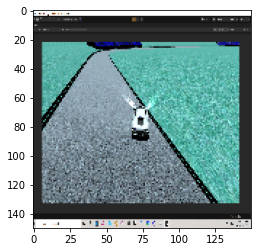

[2.2301268e-02 6.1897940e-06 3.0491609e-04 7.6485820e-02 1.7868782e-08
 1.6555324e-08 2.0016652e-02 2.0813072e-04 8.8067693e-01]
8
nokeys


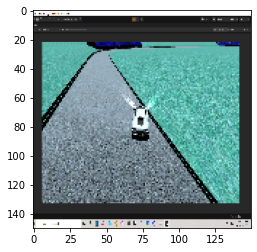

[2.2436414e-02 8.7292601e-06 3.4096921e-04 8.3451279e-02 2.2868720e-08
 1.7757600e-08 2.6212621e-02 2.6924978e-04 8.6728072e-01]
8
nokeys


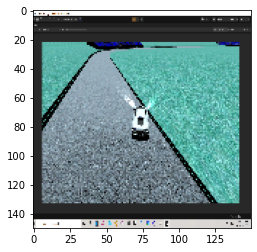

[6.5729227e-03 3.6895791e-09 8.5286316e-05 3.8858599e-04 2.5778267e-08
 4.4843267e-09 2.7541391e-06 1.7271522e-12 9.9295044e-01]
8
nokeys


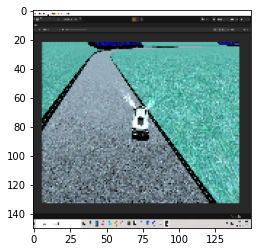

[5.7748109e-01 1.0205134e-04 3.6600852e-06 3.7203962e-01 4.6988418e-07
 2.2450019e-08 1.9044664e-03 1.3703622e-04 4.8331611e-02]
0
straight


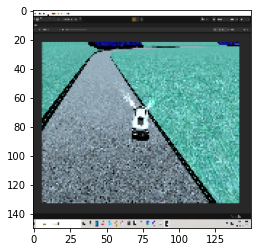

[4.1803607e-01 2.5523113e-04 2.0563759e-06 4.8393106e-01 1.8914174e-07
 1.2507923e-07 3.8601889e-03 3.8736933e-05 9.3876339e-02]
3
right


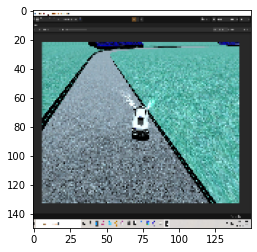

[3.5821295e-01 1.0208365e-05 5.6551222e-04 1.0761592e-02 4.9956486e-07
 2.6351881e-08 4.7965962e-03 3.4034798e-05 6.2561864e-01]
8
nokeys


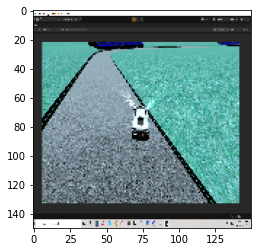

[2.9689646e-01 1.5419228e-05 1.3663196e-03 4.6354961e-03 5.0816002e-06
 3.5955963e-09 4.5853457e-03 8.1651080e-05 6.9241416e-01]
8
nokeys


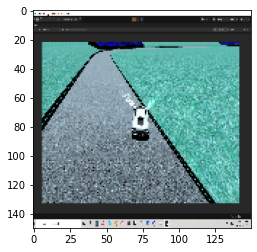

[9.0814471e-01 9.8008401e-09 2.1397227e-06 2.6348061e-03 3.2035703e-09
 4.0570772e-12 1.7415333e-07 2.2610473e-08 8.9218244e-02]
0
straight


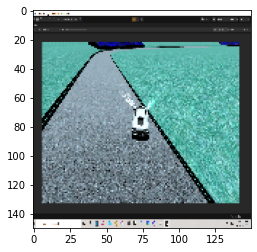

[9.7325689e-01 1.1273556e-08 1.7285583e-06 5.5267313e-04 9.1796071e-10
 2.2203074e-11 2.5365356e-08 4.9434060e-08 2.6188646e-02]
0
straight


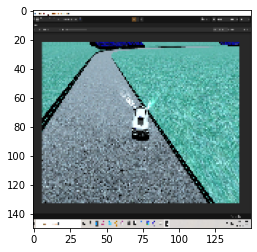

[3.96307617e-01 2.51026340e-05 2.17543329e-05 4.81350780e-01
 8.73063899e-10 3.98287225e-09 1.83624070e-04 2.51964288e-04
 1.21859126e-01]
3
right


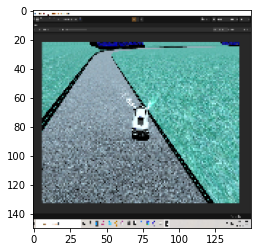

[2.7117959e-01 1.0296529e-08 2.6332407e-06 5.6927311e-01 7.0737531e-07
 3.2672021e-09 2.5136096e-06 8.6730290e-07 1.5954053e-01]
3
right


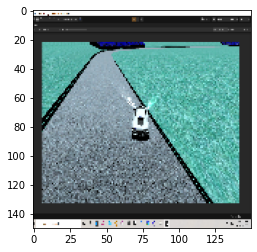

[2.4912344e-01 1.5472775e-09 7.8245561e-04 7.5431027e-02 2.8196998e-06
 3.5055518e-11 2.2929455e-03 1.8458485e-07 6.7236716e-01]
8
nokeys


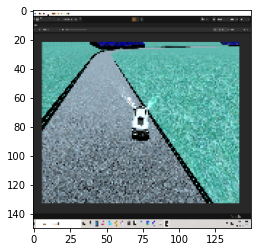

[5.9383702e-01 6.0787988e-09 3.3135782e-04 1.1069241e-01 7.1933323e-07
 1.4648605e-11 1.2403240e-03 4.0462152e-07 2.9389778e-01]
0
straight


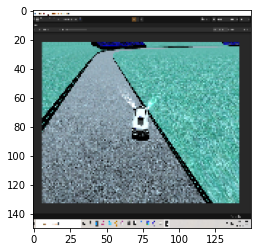

[1.88983843e-01 8.01947231e-10 2.21464670e-05 1.83141977e-01
 1.16937804e-06 3.76710552e-10 2.17948798e-02 1.05831746e-10
 6.06055975e-01]
8
nokeys


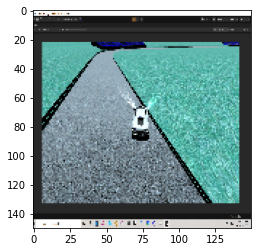

[2.2933616e-01 4.2905626e-10 4.7127878e-06 3.6285716e-01 1.0071265e-06
 1.6298689e-10 5.9033614e-03 6.4090355e-10 4.0189761e-01]
8
nokeys


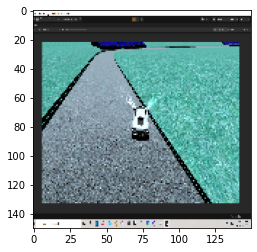

[2.27919310e-01 1.07127685e-08 1.38134874e-05 3.29964273e-02
 3.44952014e-08 2.96959701e-12 2.50701298e-04 5.13150553e-07
 7.38819301e-01]
8
nokeys


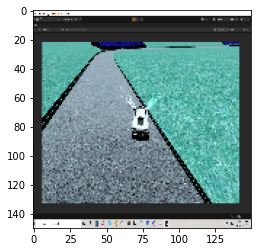

[1.9968691e-01 6.9967685e-09 5.8177407e-06 1.1264727e-02 3.5107151e-09
 5.3322624e-12 2.9945595e-04 1.3600240e-07 7.8874290e-01]
8
nokeys


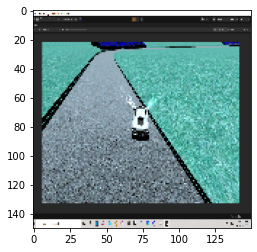

[2.05883414e-01 7.27015870e-09 5.82946905e-06 1.25751961e-02
 4.21630553e-09 6.36867512e-12 3.35729885e-04 1.15704076e-07
 7.81199753e-01]
8
nokeys


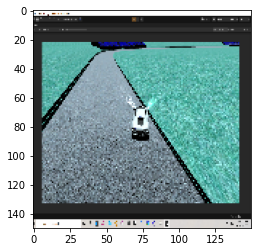

[1.8439233e-01 1.0081058e-08 7.3226252e-06 1.1989526e-02 4.2102561e-09
 6.6966450e-12 4.4399535e-04 1.4794804e-07 8.0316669e-01]
8
nokeys


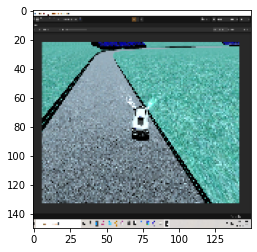

[1.7494939e-01 8.8408791e-09 6.1764003e-06 9.1858841e-03 3.4747205e-09
 5.3055689e-12 3.5831422e-04 1.2548090e-07 8.1550008e-01]
8
nokeys


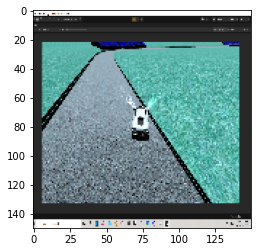

[1.8277210e-01 8.0807556e-09 5.4107550e-06 8.6653614e-03 3.1442065e-09
 4.8512006e-12 3.3315722e-04 1.0789641e-07 8.0822378e-01]
8
nokeys


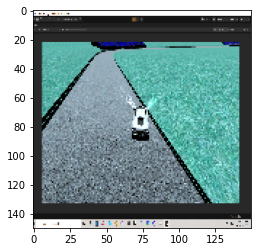

[2.0362358e-01 1.0934899e-08 5.3364129e-06 1.1856632e-02 4.1771995e-09
 6.8229602e-12 3.0560303e-04 1.3801518e-07 7.8420866e-01]
8
nokeys


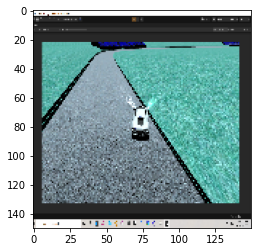

[1.82095230e-01 1.04657705e-08 6.16129091e-06 9.42848437e-03
 3.57790086e-09 6.23864502e-12 3.12781194e-04 1.44558200e-07
 8.08157146e-01]
8
nokeys


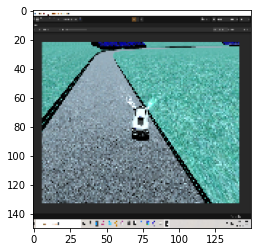

[1.7445354e-01 1.0861076e-08 6.2830281e-06 1.0463370e-02 4.1589332e-09
 4.9677012e-12 3.6642115e-04 1.6405545e-07 8.1471020e-01]
8
nokeys


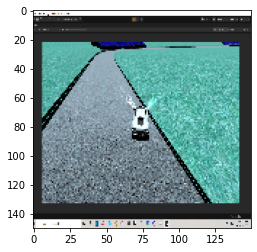

[1.7234388e-01 1.2572904e-08 6.0607176e-06 9.0949154e-03 3.4382632e-09
 6.3003032e-12 3.8912008e-04 1.3614952e-07 8.1816584e-01]
8
nokeys


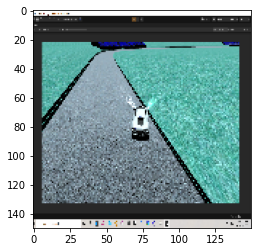

[1.9270064e-01 1.1087693e-08 5.4115271e-06 1.2013162e-02 3.7901549e-09
 7.9097813e-12 3.0508137e-04 1.5776001e-07 7.9497552e-01]
8
nokeys


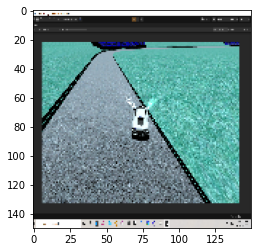

[2.8581094e-02 2.2544135e-08 6.2091439e-04 1.6380638e-02 3.3896054e-06
 2.8957940e-09 2.2500975e-05 1.1102017e-04 9.5428044e-01]
8
nokeys


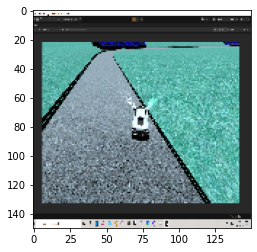

[3.1825684e-02 2.6556793e-07 2.7470745e-04 2.0263791e-02 1.2004959e-06
 4.5271559e-08 9.7222190e-05 1.0538403e-04 9.4743174e-01]
8
nokeys


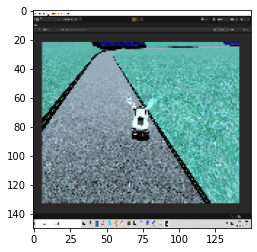

[3.0641044e-02 2.5090296e-07 2.8715449e-04 1.8145045e-02 1.2736485e-06
 4.6047685e-08 1.0842508e-04 8.8395456e-05 9.5072836e-01]
8
nokeys


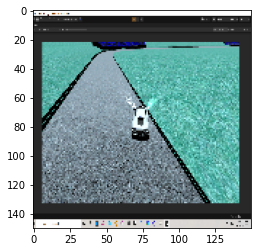

[2.7244851e-02 1.9707419e-07 2.7499520e-04 1.5538830e-02 1.0043937e-06
 3.2869011e-08 9.7185643e-05 8.2755680e-05 9.5676017e-01]
8
nokeys


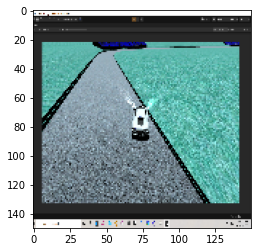

[5.8287561e-01 4.3605923e-09 7.3771074e-04 2.4226650e-03 5.0118201e-06
 1.6611491e-05 5.2892864e-03 6.1461342e-10 4.0865305e-01]
0
straight


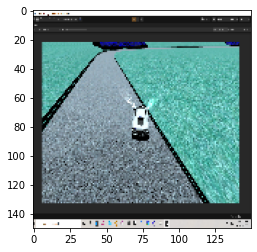

[1.1990576e-01 4.0445211e-10 7.9202587e-03 2.8522382e-02 4.2641937e-04
 1.4179332e-07 1.7728604e-04 1.5037635e-08 8.4304774e-01]
8
nokeys


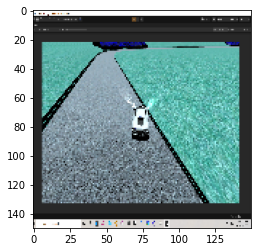

[1.8626367e-01 1.4687372e-09 1.2944695e-02 4.2792011e-02 7.9765508e-04
 4.1700093e-07 3.0573146e-04 2.9744285e-08 7.5689584e-01]
8
nokeys


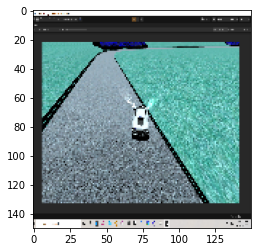

[1.9556256e-01 1.6763263e-09 1.2919393e-02 4.5221537e-02 6.1185146e-04
 4.8542068e-07 3.0992457e-04 3.8992283e-08 7.4537420e-01]
8
nokeys


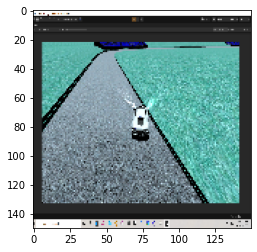

[6.3980281e-01 1.8452042e-07 1.0572624e-02 1.4575521e-02 1.8825036e-02
 6.6046578e-06 7.4859965e-03 6.4490979e-07 3.0873057e-01]
0
straight


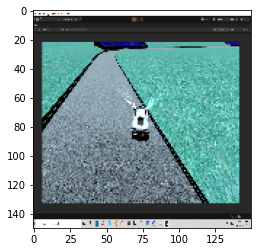

[6.4157856e-01 6.2359248e-08 1.1019047e-02 4.2157159e-03 2.5256488e-03
 1.9187871e-06 4.4344612e-03 7.5744381e-08 3.3622450e-01]
0
straight


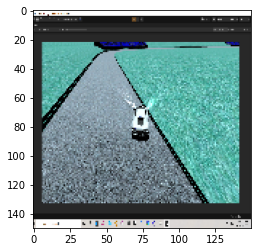

[6.9808513e-01 5.0432760e-08 8.9037465e-03 3.3861725e-03 2.6722222e-03
 2.1503845e-06 2.7809090e-03 6.9403868e-08 2.8416944e-01]
0
straight


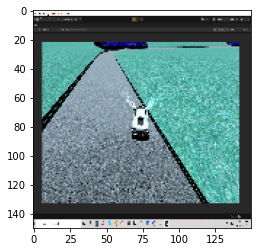

[1.24278314e-01 6.69977052e-09 1.34836079e-03 8.21218826e-04
 3.27297719e-03 8.74485480e-08 8.13769624e-02 1.61012818e-11
 7.88902223e-01]
8
nokeys


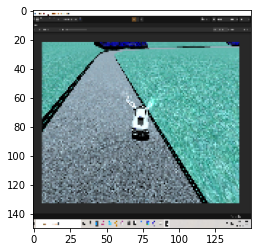

[1.9483037e-01 6.7487488e-11 6.2393417e-05 4.1517495e-05 9.2692766e-04
 6.3744503e-09 8.7633505e-03 2.8129705e-14 7.9537541e-01]
8
nokeys


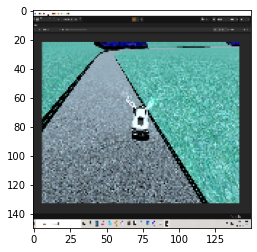

[2.0281114e-01 8.0575754e-11 7.3042887e-05 4.1753508e-05 9.5324102e-04
 7.1182829e-09 8.4988838e-03 3.2185914e-14 7.8762180e-01]
8
nokeys


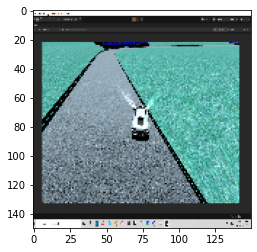

[1.2448686e-02 1.6200477e-10 3.7976544e-02 6.7965892e-05 3.1606698e-06
 1.5943822e-12 9.9859769e-03 2.3879748e-08 9.3951762e-01]
8
nokeys


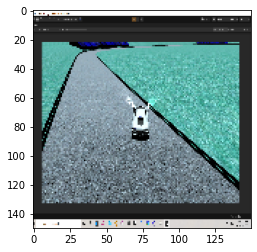

[9.8396653e-01 1.8957891e-10 4.2970976e-07 1.0399617e-02 3.4845219e-05
 2.2505382e-03 3.0920783e-10 8.1243183e-05 3.2668067e-03]
0
straight


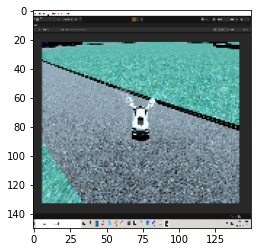

[7.8516641e-05 4.3086108e-04 9.5314801e-01 9.4650980e-09 2.6645257e-08
 1.2021335e-10 1.8047765e-04 9.5218828e-09 4.6162114e-02]
2
left


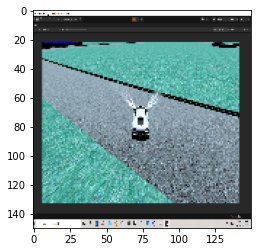

[2.4595922e-02 1.9607027e-03 9.1433018e-01 1.6363593e-03 1.3679544e-03
 1.6784825e-05 2.1474232e-04 2.6053697e-04 5.5616900e-02]
2
left


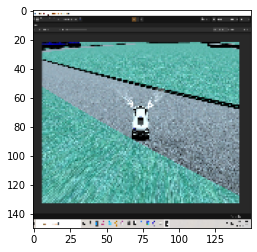

[9.6152043e-03 2.1515900e-04 2.6996318e-01 1.4681260e-04 8.7446749e-04
 9.7092041e-08 5.1671850e-07 3.4066154e-05 7.1915042e-01]
8
nokeys


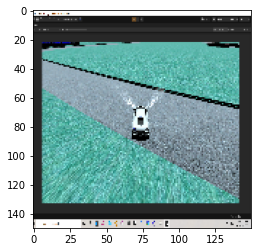

[3.6135539e-02 3.2933900e-04 8.2158083e-01 3.2892704e-03 2.0587949e-04
 3.8336770e-05 4.7583052e-07 3.9398268e-02 9.9022016e-02]
2
left


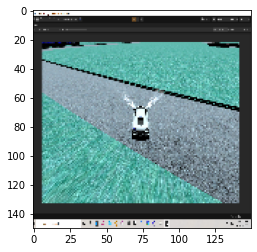

[2.3193212e-02 7.0608377e-07 9.0617764e-01 4.0602009e-03 1.6066073e-03
 2.9334039e-06 1.6617856e-08 6.6514299e-06 6.4952068e-02]
2
left


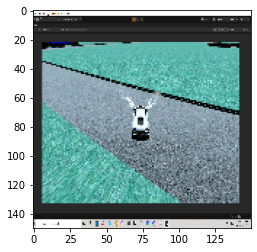

[6.6309855e-03 1.8284874e-05 9.5651346e-01 6.6349551e-04 7.1441551e-05
 2.6937701e-06 2.3001255e-06 1.9735277e-04 3.5899900e-02]
2
left


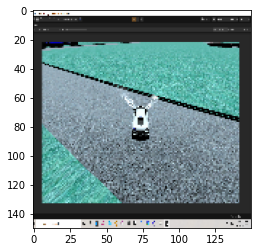

[2.2169149e-02 3.0497308e-03 2.7497330e-01 5.4146331e-06 2.7494028e-04
 4.8802131e-06 3.9699213e-03 2.3856453e-06 6.9555020e-01]
8
nokeys


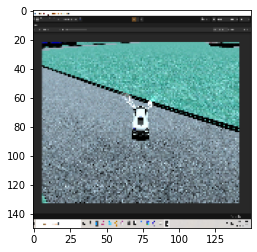

[9.4971200e-03 3.8437854e-04 6.6325068e-01 1.4629733e-05 3.7684643e-03
 1.3391048e-07 9.3041264e-05 3.8246794e-06 3.2298771e-01]
2
left


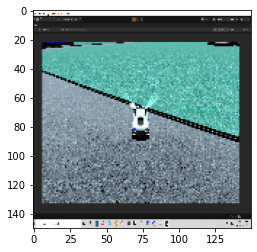

[1.21511184e-05 9.42945182e-01 9.02044212e-06 9.13698699e-08
 1.14498459e-06 2.83814250e-10 1.06492196e-04 5.49539439e-02
 1.97192910e-03]
1
reverse


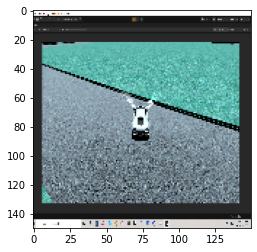

[1.8500380e-03 2.5417473e-02 1.2551969e-01 1.3966476e-04 9.2392880e-04
 4.3437599e-06 4.3255568e-05 2.8430528e-03 8.4325856e-01]
8
nokeys


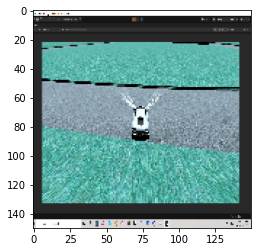

[6.2199571e-04 4.7911062e-06 6.5206038e-04 5.3173983e-03 2.1136661e-04
 4.7210211e-08 3.4780232e-06 8.8539726e-01 1.0779158e-01]
7
reverse+right


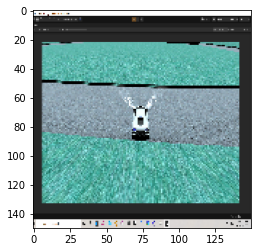

[1.2928705e-01 1.4997130e-04 1.4903386e-02 7.2352037e-02 5.6599866e-04
 1.2112178e-03 1.7360189e-05 5.5635953e-01 2.2515345e-01]
7
reverse+right


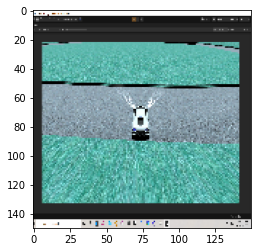

[1.02826925e-02 7.43985720e-06 2.19595764e-04 3.83779287e-01
 4.19503385e-06 1.79348383e-04 5.60579103e-08 2.41272643e-01
 3.64254743e-01]
3
right


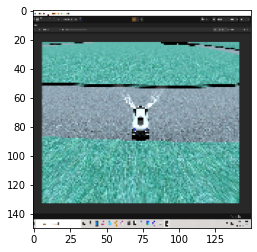

[9.1534836e-05 5.8715966e-07 9.3513314e-05 9.1161466e-01 6.9701129e-09
 1.7954007e-05 4.4946504e-09 8.0061043e-05 8.8101625e-02]
3
right


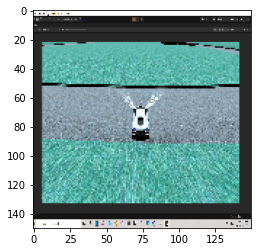

[2.8627730e-04 7.2521943e-06 2.2481108e-01 7.7317772e-03 5.2302919e-05
 9.8186172e-07 5.7722900e-06 5.8517568e-03 7.6125282e-01]
8
nokeys


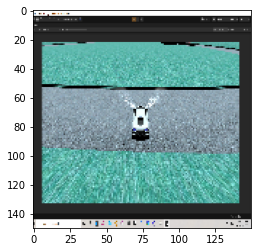

[4.9746636e-04 4.6792667e-04 2.6560486e-03 8.9299031e-02 7.8662357e-05
 5.9414924e-06 5.2805164e-05 6.2240373e-02 8.4470183e-01]
8
nokeys


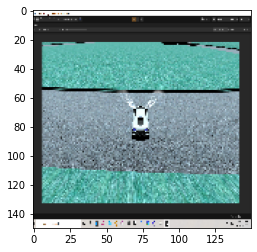

[9.7456004e-04 9.6655786e-03 8.0241379e-04 3.8147095e-01 5.3036794e-05
 2.8508507e-06 5.0880226e-05 1.9541389e-01 4.1156587e-01]
8
nokeys


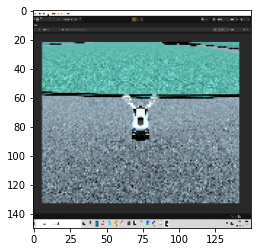

[5.1612359e-02 4.2796126e-03 7.8173436e-02 7.7626493e-04 5.3979601e-03
 3.9959436e-06 1.7259344e-02 2.1997688e-03 8.4029740e-01]
8
nokeys


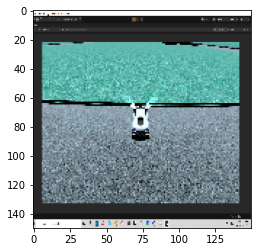

[1.3190366e-02 2.5619414e-01 2.4385499e-04 4.2283041e-03 4.0958080e-04
 1.4300839e-04 4.4810516e-03 3.2653089e-03 7.1784443e-01]
8
nokeys


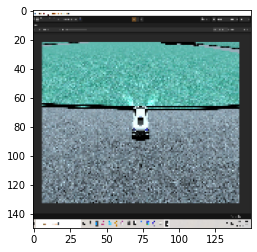

[1.1142876e-01 3.0895855e-02 1.5927313e-03 1.6060797e-04 6.6707179e-02
 1.5090610e-03 7.9656567e-04 7.8204830e-05 7.8683102e-01]
8
nokeys


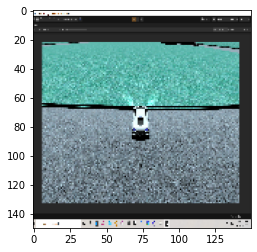

[2.7791741e-01 1.1475678e-01 1.1063723e-03 1.3044111e-03 2.8615195e-02
 2.0103473e-02 3.1198928e-04 2.0403818e-04 5.5568033e-01]
8
nokeys


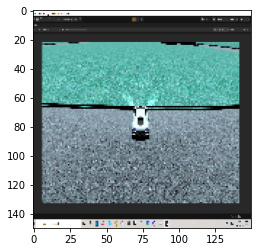

[7.6718211e-02 2.6271817e-01 3.8707012e-04 1.1664425e-02 9.0120230e-03
 1.9773219e-03 1.1011885e-02 7.7643856e-02 5.4886711e-01]
8
nokeys


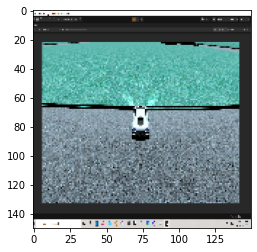

[1.3647296e-01 5.1252061e-01 4.6341447e-04 3.4509860e-03 3.9372373e-02
 7.5107664e-03 7.0390949e-04 8.0088258e-04 2.9870412e-01]
1
reverse


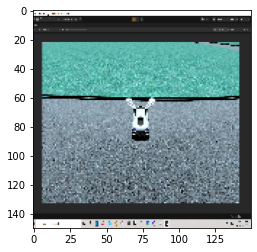

[1.5063934e-03 5.4901179e-06 3.5644297e-02 3.8611597e-06 5.7744165e-04
 1.0720105e-07 1.0795662e-04 3.1783318e-07 9.6215421e-01]
8
nokeys


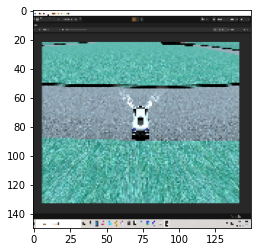

[1.7799850e-03 1.3000052e-04 2.6246818e-02 4.7340906e-01 4.3879839e-07
 5.5500695e-05 7.4213863e-06 4.8607629e-04 4.9788481e-01]
8
nokeys


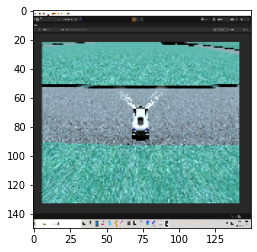

[1.0718717e-03 3.0163259e-05 6.4479462e-03 4.8609335e-02 6.2249910e-06
 7.4984673e-06 1.7046329e-04 3.0868284e-02 9.1278815e-01]
8
nokeys


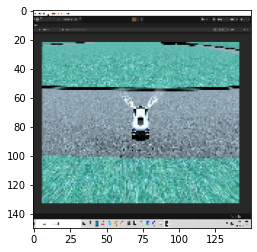

[1.6107549e-03 4.5467800e-04 2.3899850e-02 5.4790478e-02 4.2765907e-05
 3.0623403e-05 8.5448206e-05 3.0032456e-01 6.1876088e-01]
8
nokeys


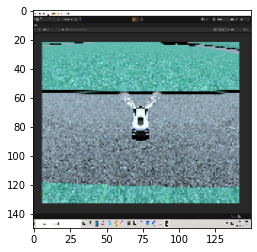

[8.4132125e-04 5.8438181e-04 1.9859604e-04 7.9504572e-02 6.1681999e-06
 7.2634437e-05 8.8394950e-07 1.0717848e-01 8.1161284e-01]
8
nokeys


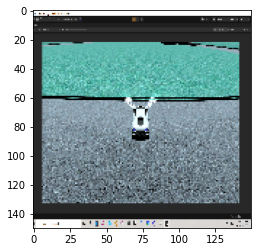

[3.3330466e-03 1.8388882e-05 9.4052768e-01 2.0999287e-06 2.2817656e-04
 1.3246952e-08 7.6500350e-04 1.8487379e-04 5.4940667e-02]
2
left


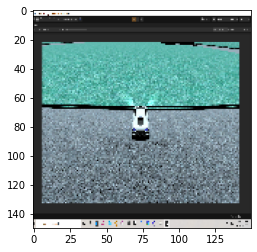

[1.7838594e-01 3.0394108e-03 1.4200468e-01 1.6396744e-02 2.6929963e-02
 4.6455729e-04 9.2159107e-04 3.8308680e-02 5.9354842e-01]
8
nokeys


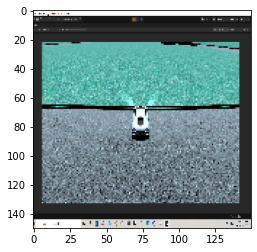

[1.3619702e-02 8.3753948e-05 5.2908516e-01 6.6616471e-05 6.9376046e-04
 2.7758106e-06 6.7527860e-04 1.4268039e-05 4.5575878e-01]
2
left


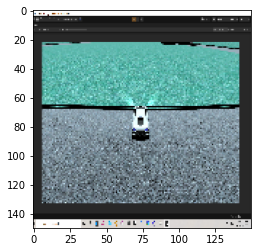

[1.8094916e-02 8.1954015e-05 7.5420284e-01 7.0462789e-05 1.8461886e-03
 2.4163985e-06 5.7262223e-04 4.4209673e-04 2.2468656e-01]
2
left


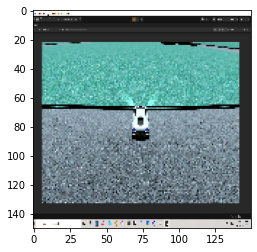

[1.5712265e-02 1.9694719e-04 6.7303222e-01 4.6060977e-05 6.7603152e-04
 6.3119603e-07 1.1709408e-03 6.0550193e-04 3.0855939e-01]
2
left


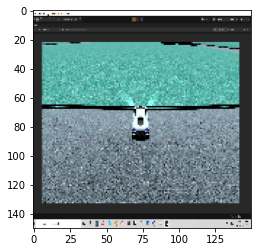

[1.4679465e-02 3.7987172e-04 8.0992210e-01 6.8772068e-05 3.8367455e-04
 1.1196788e-06 1.0765715e-03 1.0575767e-03 1.7243084e-01]
2
left


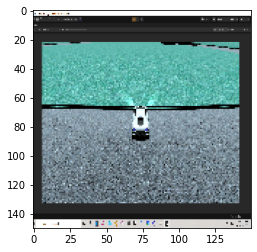

[3.61880809e-02 3.75972129e-04 8.30887079e-01 9.79766701e-05
 2.46039536e-02 1.77367056e-05 1.45189872e-03 5.81066450e-03
 1.00566655e-01]
2
left


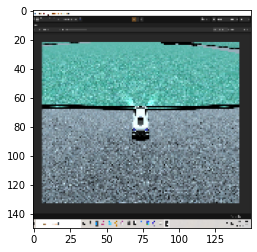

[1.76570714e-02 1.16846124e-04 9.22511339e-01 2.78817588e-05
 2.90828831e-02 5.53174732e-06 5.95798425e-04 4.51256754e-03
 2.54900474e-02]
2
left


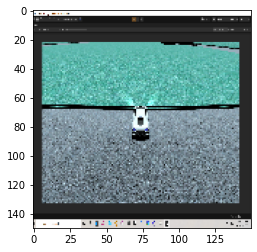

[8.4391460e-03 2.3070779e-05 9.4285697e-01 1.1330300e-05 2.1601863e-02
 8.7082736e-07 1.4037784e-04 2.8337477e-04 2.6642988e-02]
2
left


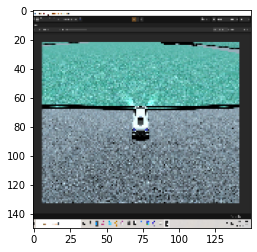

[1.4202268e-02 2.3200653e-05 9.2002404e-01 3.1842876e-05 2.4019390e-02
 8.1253245e-07 2.8442591e-04 1.5520365e-03 3.9862122e-02]
2
left


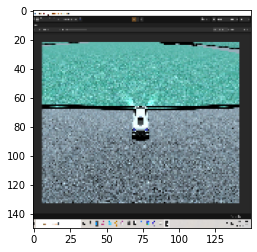

[2.0590765e-02 2.7316075e-05 8.8875157e-01 4.8686281e-05 2.8188076e-02
 6.8612900e-07 5.9421890e-04 3.6992913e-03 5.8099359e-02]
2
left


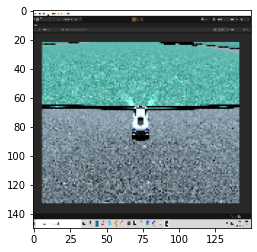

[2.6544955e-02 1.7962639e-05 8.6765832e-01 5.5141347e-05 2.6809299e-02
 8.8972354e-07 2.9042753e-04 3.3883238e-03 7.5234726e-02]
2
left


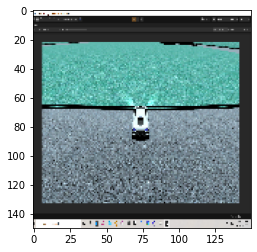

[2.0811537e-02 1.0958469e-05 9.0510303e-01 1.7839962e-05 1.5343874e-02
 2.6356656e-07 9.7816298e-04 3.3367542e-03 5.4397553e-02]
2
left


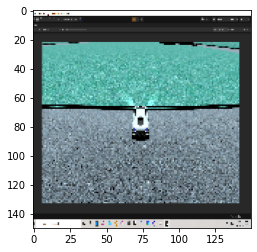

[2.0428333e-02 1.0002768e-05 8.9909536e-01 1.1513270e-05 2.0495363e-02
 1.9618098e-07 9.0378831e-04 1.4717631e-03 5.7583738e-02]
2
left


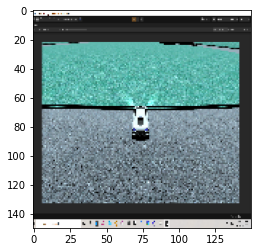

[1.3428735e-02 1.1870198e-05 9.1559166e-01 1.6591535e-05 1.3779951e-02
 2.5787421e-07 2.3191622e-04 2.2591326e-04 5.6713067e-02]
2
left


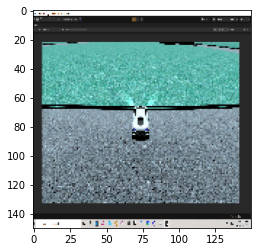

[7.5252508e-03 1.6277147e-05 8.3205152e-01 1.5884349e-06 8.8806748e-02
 1.6062392e-08 1.6323669e-04 2.2429958e-04 7.1210973e-02]
2
left


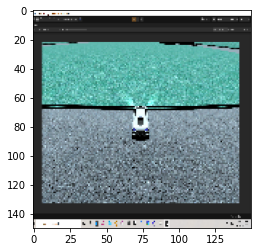

[6.2995471e-02 1.7048337e-03 3.2674250e-01 4.3203388e-04 1.1702566e-01
 2.9063583e-06 1.5186853e-03 9.1472914e-04 4.8866323e-01]
8
nokeys


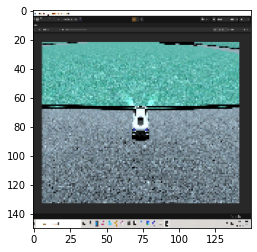

[9.2157731e-03 2.4552692e-05 7.2119665e-01 1.6708890e-06 2.0070289e-01
 2.0409058e-08 9.7957738e-05 9.0619949e-05 6.8669915e-02]
2
left


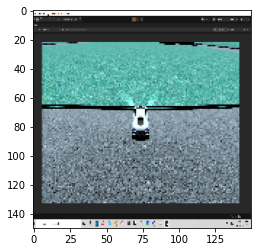

[4.2877149e-02 8.0623379e-04 3.4475517e-01 5.0184136e-04 1.4763872e-01
 2.6561117e-06 9.8668470e-04 9.4100018e-04 4.6149051e-01]
8
nokeys


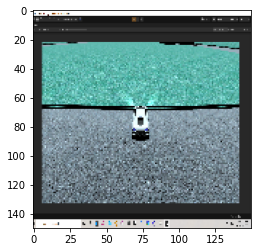

[1.4697386e-02 5.2473355e-05 4.2538235e-01 2.6608650e-06 4.7140506e-01
 2.4360602e-08 8.8907524e-05 4.5370605e-05 8.8325799e-02]
4
forward+left


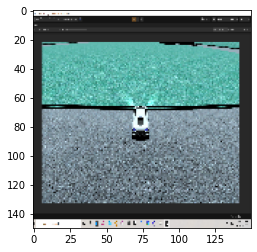

[3.0261548e-02 1.8699013e-04 4.9200711e-01 1.0695341e-04 1.0934142e-01
 5.3922992e-07 7.8748987e-04 3.2147329e-04 3.6698651e-01]
2
left


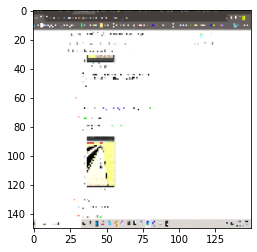

[5.6213466e-04 4.8839971e-01 4.4677756e-03 2.2447041e-06 1.1832065e-08
 3.5508606e-06 1.6672869e-03 3.1283307e-07 5.0489700e-01]
8
nokeys


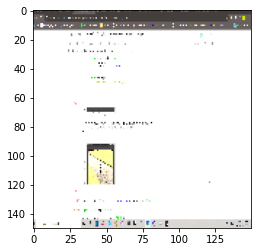

[4.1925561e-04 9.4091332e-01 1.1186137e-04 8.3871946e-08 1.8089155e-10
 1.7934229e-07 1.0490318e-06 1.1675947e-07 5.8554072e-02]
1
reverse


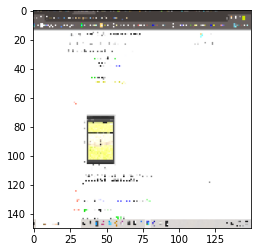

[5.8188410e-03 1.1489372e-01 4.4940662e-04 5.5616774e-06 2.1517744e-08
 1.3258658e-06 1.5538048e-04 1.1170554e-06 8.7867463e-01]
8
nokeys


KeyboardInterrupt: 

In [50]:
main()

In [27]:
trdt=np.load('E:/v11/Copy of training_data-1.npy', allow_pickle=True)

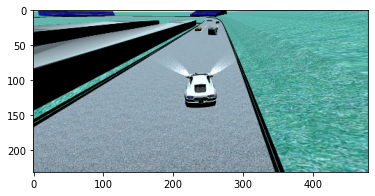

In [69]:
import matplotlib.pyplot as plt

plt.imshow(trdt[0,0][30:-8,:])
plt.show()

In [36]:
trdt[0,1]

[1, 0, 0, 0, 0, 0, 0, 0, 0]

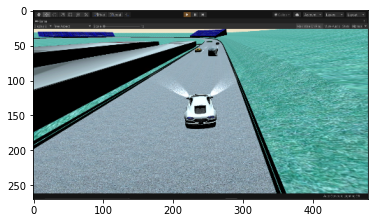

In [66]:
plt.imshow(trdt[1,0])
plt.show()

In [38]:
trdt[1,1]

[1, 0, 0, 0, 0, 0, 0, 0, 0]

In [39]:
plt.imshow(screen)
plt.show()

NameError: name 'screen' is not defined